In [1]:
##### Autorin:  Simin Ghasempour Sis
##### Srat Datum:    2025.11.28
##### Ort:      SkySails Group, Wendenstraße 375, Hamburg
##### 
### Ziel:     
#####           Fokus: Wicklungstemperatur mit einem Einkörper Modell
#####           Wärmequelle: Kupferverluste
#####           Methode: R_final=R0*R_Lüfter/(R0+R_Lüfter)

In [2]:
import os # für Verzeichnis lesen oder ändern
import pandas as pd # für read_parquet
import numpy as np # Für mathematische Operationen wie exp(), für np.gradient
import plotly.graph_objects as go # Für ein interaktives Plot mit Vergrößerungsmöglichkeit.
from scipy.interpolate import interp1d # Für Lüfterwiderstanf Kennlinie

In [16]:
# Parameter
RC_sehr_kurz=0.333*3600     # 20 Minuten
RC_kurz=0.475*3600        # 28.5 Minuten
RC_mittel=5*3600
RC_lang=10*3600

# Flugfenster
start= '2025-10-06 11:56:00.000'
end= '2025-10-06 15:00:00.000'

# Kupfer Verluste
Rs_Kalt=0.003                    # Rs_Kalt[Ohm], von STW Datenblat, wahrscheinlich in 20°C
ro_20= 0.017*0.000001            # ro_20[Ohm*m]
Alfa=4.3*0.001                   # Alfa[1/K]
Beta= 0.6*0.000001               # Beta[1/K^2]

# Gleitender Mittelwert Filter 
window_size = 1400                # Anzahl der Samples im Mittelwertfenster

# Lüfter Kennlinie: Formel Methode
optimized_a =  0.001   
optimized_b = 1.200
A=1.227734409022891              # Außenoberfläche der Wicklung 
n = np.arange(1, 3000)
Lüfter_Kennlinie=1/(A*optimized_a * n ** optimized_b)    # R_Lüfter(n)=1/[a*n^b]

# Lüfter Kennlinie: Lookup Tabelle Methode
x_bekannt = [0, 250, 500, 1000, 1500, 2000, 2500, 3000] 
y_bekannt = [3, 0.3, 0.15, 0.08, 0.05, 0.1, 0.15, 0.2]

Lookup_Tabelle_Lüfter_Kennlinie= np.interp(n, x_bekannt, y_bekannt)

In [17]:
# Temperaturvorhersagen
def berechne_v(t, iS, R, C, v0):
    t = np.array(t)
    iS = np.array(iS)
    R = np.array(R)
    C = np.array(C)
    
    v = np.zeros_like(t)
    v[0] = v0
    dt = np.diff(t)

    for i in range(1, len(t)):
        dv_dt = (iS[i-1] - v[i-1]/R[i-1]) / C[i-1]     # Differentialgleichung: Cdv(t)/dt+v(t)/R=is(t) 
        v[i] = v[i-1] + dv_dt * dt[i-1]           # Differentiation aequation: dv(t)/dt=[v(t)-v(t-delta_t)]/delta_t
        
    return v

In [18]:
# Dataframe df_Ground
os.chdir(r"M:\01 Messdaten\PN14.02_KLX\00_NightlyDownloads\parquet\sfs2\logs_2025-10-06T00-00-00_to_2025-10-07T00-00-00_KLX_SFS2") # Verzeichnis ändern
df_GroundControl_Tag1 = pd.read_parquet("2025-10-06T00-00-00_to_2025-10-07T00-00-00_KLX_SFS2_GroundControl.parquet", columns=['time', 'STW_LineLength', 'STW_Motor1_Current', 'STW_Motor1_Temp_C', 'SacContainerAirTempInDegC', 'SacContainerAirTempOutDegC', 'StwActualMotorFanSpeedRPM', 'StwCmdMotorFanSpeedRPM', 'TemperatureStwMotorHousing', 'STW_powerEstimate_kW', 'STW_ShuntDCPower', 'STW_Motor_RPM', 'STW_TorqueFC1', 'STW_LineSpeed'])

df_Ground = df_GroundControl_Tag1
df_Ground.iloc[[0,-1]]

,time,STW_LineLength,STW_Motor1_Current,STW_Motor1_Temp_C,SacContainerAirTempInDegC,SacContainerAirTempOutDegC,StwActualMotorFanSpeedRPM,StwCmdMotorFanSpeedRPM,TemperatureStwMotorHousing,STW_powerEstimate_kW,STW_ShuntDCPower,STW_Motor_RPM,STW_TorqueFC1,STW_LineSpeed
0,2025-10-05 23:59:57.900,2.77625,0.0,12.5,12.7,14.4274,0.0,2600.0,12.7,0.0,600.0,0.0,0.0,0.0
863999,2025-10-06 23:59:57.800,3.61346,0.0,25.0,15.2,15.9487,0.0,2600.0,23.3,0.0,600.0,0.0,0.0,0.0


In [19]:
# Anzahl der NaN-Werte in der Spalte
a1=df_Ground['time'].isna().sum()
a2=df_Ground['STW_LineLength'].isna().sum()
a3=df_Ground['STW_Motor1_Current'].isna().sum()
a4=df_Ground['STW_Motor1_Temp_C'].isna().sum()
a5=df_Ground['SacContainerAirTempOutDegC'].isna().sum()
a6=df_Ground['SacContainerAirTempInDegC'].isna().sum()
a7=df_Ground['StwActualMotorFanSpeedRPM'].isna().sum()
a8=df_Ground['StwCmdMotorFanSpeedRPM'].isna().sum()
a9=df_Ground['TemperatureStwMotorHousing'].isna().sum()
a10=df_Ground['STW_powerEstimate_kW'].isna().sum()
a11=df_Ground['STW_ShuntDCPower'].isna().sum()
a12=df_Ground['STW_Motor_RPM'].isna().sum()
a13=df_Ground['STW_TorqueFC1'].isna().sum()
a14=df_Ground['STW_LineSpeed'].isna().sum()

print(f"Anzahl der NaN-Werte:")
print(f"time: {a1}")
print(f"STW_LineLength: {a2}")
print(f"STW_Motor1_Current: {a3}")
print(f"STW_Motor1_Temp_C: {a4}")
print(f"SacContainerAirTempOutDegC: {a5}")
print(f"SacContainerAirTempInDegC: {a6}")
print(f"StwActualMotorFanSpeedRPM: {a7}")
print(f"StwCmdMotorFanSpeedRPM: {a8}")
print(f"TemperatureStwMotorHousing: {a9}")
print(f"STW_powerEstimate_kW: {a10}")
print(f"STW_ShuntDCPower: {a11}")
print(f"STW_Motor_RPM: {a12}")
print(f"STW_TorqueFC1: {a13}")
print(f"STW_LineSpeed: {a14}")

Anzahl der NaN-Werte:
time: 0
STW_LineLength: 0
STW_Motor1_Current: 0
STW_Motor1_Temp_C: 6
SacContainerAirTempOutDegC: 6
SacContainerAirTempInDegC: 6
StwActualMotorFanSpeedRPM: 6
StwCmdMotorFanSpeedRPM: 6
TemperatureStwMotorHousing: 6
STW_powerEstimate_kW: 6
STW_ShuntDCPower: 6
STW_Motor_RPM: 6
STW_TorqueFC1: 6
STW_LineSpeed: 0


In [20]:
# Nan-Werte ersetzen
df_Ground['time'] = df_Ground['time'].interpolate()
df_Ground['STW_LineLength'] = df_Ground['STW_LineLength'].interpolate()
df_Ground['STW_Motor1_Current'] = df_Ground['STW_Motor1_Current'].interpolate()
df_Ground['STW_Motor1_Temp_C'] = df_Ground['STW_Motor1_Temp_C'].interpolate()
df_Ground['SacContainerAirTempOutDegC'] = df_Ground['SacContainerAirTempOutDegC'].interpolate()
df_Ground['SacContainerAirTempInDegC'] = df_Ground['SacContainerAirTempInDegC'].interpolate()
df_Ground['StwActualMotorFanSpeedRPM'] = df_Ground['StwActualMotorFanSpeedRPM'].interpolate()
df_Ground['StwCmdMotorFanSpeedRPM'] = df_Ground['StwCmdMotorFanSpeedRPM'].interpolate()
df_Ground['TemperatureStwMotorHousing'] = df_Ground['TemperatureStwMotorHousing'].interpolate()
df_Ground['STW_powerEstimate_kW'] = df_Ground['STW_powerEstimate_kW'].interpolate()
df_Ground['STW_ShuntDCPower'] = df_Ground['STW_ShuntDCPower'].interpolate()
df_Ground['STW_Motor_RPM'] = df_Ground['STW_Motor_RPM'].interpolate()
df_Ground['STW_TorqueFC1'] = df_Ground['STW_TorqueFC1'].interpolate()
df_Ground['STW_LineSpeed'] = df_Ground['STW_LineSpeed'].interpolate()

In [21]:
# Dataframe df_Ground_small & df_Pod_small
df_Ground_small = df_Ground[(df_Ground['time'] >= start) & (df_Ground['time'] <= end)]

df_Ground_small = df_Ground_small.sort_values(by='time').reset_index(drop=True)

df_Ground_small.iloc[[0,-1]]

,time,STW_LineLength,STW_Motor1_Current,STW_Motor1_Temp_C,SacContainerAirTempInDegC,SacContainerAirTempOutDegC,StwActualMotorFanSpeedRPM,StwCmdMotorFanSpeedRPM,TemperatureStwMotorHousing,STW_powerEstimate_kW,STW_ShuntDCPower,STW_Motor_RPM,STW_TorqueFC1,STW_LineSpeed
0,2025-10-06 11:56:00,-0.303345,0.0,15.5,17.7,18.3248,801.0,800.0,16.3,0.0,600.0,0.0,0.0,0.0
110400,2025-10-06 15:00:00,194.287000,0.0,38.6,19.2,17.8632,0.0,2600.0,30.2,0.0,600.0,0.0,0.0,0.0


In [22]:
# Dataframe df
df = df_Ground_small

df=df.copy()

df['time_s'] = (df['time'] - df['time'].iloc[0]).dt.total_seconds()

# Die Temperaturen
df['T0'] = (df['SacContainerAirTempOutDegC'] + df['SacContainerAirTempInDegC']) / 2
df['T1'] = df['STW_Motor1_Temp_C']
df['T2'] = df['TemperatureStwMotorHousing']
df['T1-T0'] = df['T1'] - df['T0']

# Kupfer Verluste
df['ro']=ro_20*(1+Alfa*(df['T1']-20)+Beta*(df['T1']-20)*(df['T1']-20))
df['Kupf_Ver_kW'] = 0.001*df['ro']*(Rs_Kalt/ro_20)*df['STW_Motor1_Current']**2
df['filtered_Kupf_Ver_kW_MA']=df['Kupf_Ver_kW'].rolling(window=window_size, center=True).mean()

# Lüfter Drehzahl
df['Lüfter_Drehzahl_rpm']=df['StwActualMotorFanSpeedRPM']

# R_Lüfter: Formel Methode
#df['R_Lüfter']=1/(A*optimized_a*df['Lüfter_Drehzahl_rpm']**optimized_b)

# R_Lüfter: Look-up Tabelle Methode
df['R_Lüfter']= np.interp(df['Lüfter_Drehzahl_rpm'], x_bekannt, y_bekannt)

In [23]:
# Modell 0
C0=70*385
R0=RC_kurz/C0

# T1 berechnen
df['C0']=C0
df.loc[df['STW_Motor1_Current'] == 0, 'C0'] = 10 * C0
df['R_final0']=(R0*df['R_Lüfter'])/(R0+df['R_Lüfter'])
df.loc[df['Lüfter_Drehzahl_rpm'] == 0, 'R_final0'] = R0
df['R_final0'] = df['R_final0'].interpolate()     #füllt Lücken zwischen Punkten
df['v0']= berechne_v(df['time_s'].values, 1000*df['Kupf_Ver_kW'].values, df['R_final0'], df['C0'], df['T1-T0'].iloc[0])
df['T1_berechnet0'] = df['v0']+df['T0']

# Error berechnen
df['T1_Error0']= df['T1_berechnet0']-df['T1']

print(f"C0: {C0:.1f}")          
print(f"R0: {R0:.4f}")        
print(f"C0 * R: {C0*R0:.4f} ={C0*R0/3600:.4f} Stunden") 

# Error zeigen
print(f"Max Error0: {df['T1_Error0'].abs().max():.1f}")
print(f"RMS0: {np.sqrt(np.mean(df['T1_Error0']**2)):.1f}")           #Root Mean Square (Quadratischer Mittelwert)
print(f"MAE0: {np.mean(np.abs(df['T1_Error0'])):.1f}")               #Mean Absolute Error (Mittlerer absoluter Fehler)

C0: 26950.0
R0: 0.0635
C0 * R: 1710.0000 =0.4750 Stunden
Max Error0: 8.7
RMS0: 2.6
MAE0: 1.9


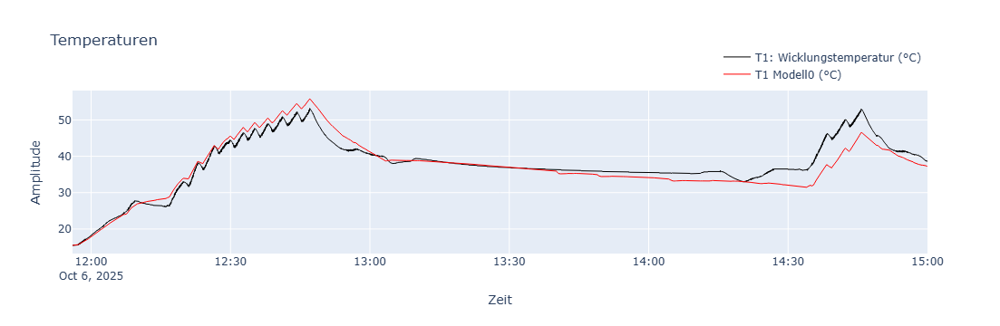

In [24]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['time'], y=df['T1'], mode='lines', name='T1: Wicklungstemperatur (°C)',line=dict(width=1, color='black')))
fig.add_trace(go.Scatter(x=df['time'], y=df['T1_berechnet0'], mode='lines', name='T1 Modell0 (°C)',line=dict(width=1, color='red')))
fig.update_layout(title='Temperaturen',xaxis_title='Zeit',yaxis_title='Amplitude',hovermode='closest',
    xaxis=dict(range=[start, end]),
    legend=dict(x=1,y=10,xanchor='right',yanchor='top', bgcolor='rgba(0,0,0,0)'))
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['time'], y=df['STW_LineLength'], mode='lines', name='Seillänge (m)',line=dict(width=1, color='blue')))
fig.add_trace(go.Scatter(x=df['time'], y=df['Lüfter_Drehzahl_rpm'], mode='lines', name='Lüfter Drehzahl (rpm)',line=dict(width=1, color='lime')))
fig.add_trace(go.Scatter(x=df['time'], y=df['STW_Motor1_Current'], mode='lines', name='STW Motor Strom (A)',line=dict(width=1, color='gray')))
fig.update_layout(title='Flug Angaben',xaxis_title='Zeit',yaxis_title='Amplitude',hovermode='closest',
    xaxis=dict(range=[start, end]),
    legend=dict(x=1,y=10,xanchor='right',yanchor='top', bgcolor='rgba(0,0,0,0)'))
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=n,y=Lüfter_Kennlinie,mode='lines',name='Lüfter Kennlinie',line=dict(width=1)))
fig.add_trace(go.Scatter(x=n,y=Lookup_Tabelle_Lüfter_Kennlinie,mode='lines',name='Lookup Tabelle Lüfter Kennlinie',line=dict(width=1)))
fig.update_layout(title='Lüfter Kennlinie',xaxis_title='Lüfter Drehzahl (rpm)',yaxis_title='Widerstand (Ohm)',hovermode='closest',
    xaxis=dict(range=[0, 3000]),
    yaxis=dict(range=[0, 5]),
    legend=dict(x=1,y=1,xanchor='right',yanchor='top',bgcolor='rgba(0,0,0,0)'))
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['time'], y=df['R_Lüfter'], mode='lines', name='Lüfter (ohm)',line=dict(width=1, color='gold')))
fig.add_trace(go.Scatter(x=df['time'], y=df['R_final0'], mode='lines', name='R final Modell0(ohm)',line=dict(width=1, color='red')))
fig.update_layout(title='Thermischer Widerstand',xaxis_title='Zeit',yaxis_title='Amplitude',hovermode='closest',
    xaxis=dict(range=[start, end]),
    legend=dict(x=1,y=10,xanchor='right',yanchor='top', bgcolor='rgba(0,0,0,0)'))
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['time'], y=0.01*df['STW_LineLength'], mode='lines', name='0.01*Seillänge (m)',line=dict(width=1, color='blue')))
fig.add_trace(go.Scatter(x=df['time'], y=df['Kupf_Ver_kW'], mode='lines', name='Pcu: Kupfer Verluste (kW)',line=dict(width=1, color='Cyan')))
fig.add_trace(go.Scatter(x=df['time'], y=df['filtered_Kupf_Ver_kW_MA'], mode='lines', name='gefilterte Pcu (kW)',line=dict(width=1, color='olive')))
fig.update_layout(title='Kupfer Verluste',xaxis_title='Zeit',yaxis_title='Amplitude',hovermode='closest',
    xaxis=dict(range=[start, end]),
    legend=dict(x=1,y=10,xanchor='right',yanchor='top', bgcolor='rgba(0,0,0,0)'))
fig.show()